# Calculate Arrival Times

In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from dask.distributed import Client
from xrsignal import xrsignal
from scipy import signal
from NI_tools.NI_tools import inversion
import hvplot.xarray
import holoviews as hv
import scipy

plt.rcParams.update({
    'text.usetex':True,
    'font.family':'serif',
    'font.size':18
})

import seaborn as sns
# set the theme
sns.set_palette('inferno', 4)

In [2]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 32,Total memory: 62.80 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:43575,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 32
Started: Just now,Total memory: 62.80 GiB
Comm: tcp://127.0.0.1:33687,Total threads: 4
Dashboard: http://127.0.0.1:41743/status,Memory: 7.85 GiB
Nanny: tcp://127.0.0.1:34133,


## Remove Outliers

In [17]:
fn = '/datadrive/NCCFs/1hr_20150101_20230101_ec_cc.nc'
NCCFs = xr.open_dataarray(fn).chunk({'delay':11999, 'time':100})
NCCFs = NCCFs.rename({'time':'dates'})

time_coord = pd.to_datetime(np.arange(pd.Timestamp('2015-01-01').value, pd.Timestamp('2023-01-01').value, 1e9*3600))
NCCFs = NCCFs.assign_coords({'dates':time_coord})

In [1]:
NCCFs.plot.hist()

NameError: name 'NCCFs' is not defined

In [18]:
energy = (NCCFs*NCCFs).mean('delay').compute()
energy_norm = (energy)/energy.std()

### Create Figure of Energy Distribution

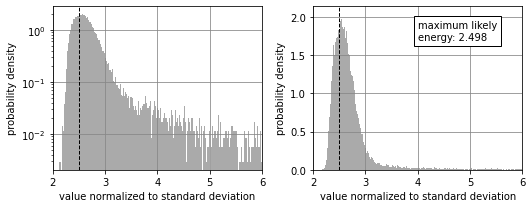

In [5]:
fig = plt.figure(figsize=(7.5,3))
plt.subplot(1,2,1)
ax = plt.gca()
hist = energy_norm.plot.hist(bins=np.linspace(0,6,1000), density=True, yscale='log',color='#AAAAAA')
plt.xlim([2,6])
plt.grid(color='#888888')
plt.ylabel('probability density')
plt.xlabel('value normalized to standard deviation')
ylims = ax.get_ylim()

plt.plot([hist[1][np.argmax(hist[0])], hist[1][np.argmax(hist[0])]], ylims, '--k', linewidth=1)
plt.ylim(ylims)

plt.subplot(1,2,2)
ax = plt.gca()

hist = energy_norm.plot.hist(bins=np.linspace(0,6,1000), density=True, yscale='linear', color='#AAAAAA')
plt.xlim([2,6])
plt.grid(color='#888888')
plt.ylabel('probability density')
plt.xlabel('value normalized to standard deviation')

ylims = ax.get_ylim()
plt.plot([hist[1][np.argmax(hist[0])], hist[1][np.argmax(hist[0])]], ylims, '--k', linewidth=1)
plt.ylim(ylims)
plt.tight_layout()
plt.text(4, 1.7, f'maximum likely\nenergy: {hist[1][np.argmax(hist[0])]:1.3f}',
        bbox=dict(facecolor='white', edgecolor='black'))

fig.savefig('figures/energy_distribution.png', dpi=300)

### Choose energy threshold
- manually inspecting hour long nccf
- considering percentage of data thrown out

In [19]:
threshold = 3
mask = energy_norm <= threshold
nan_mask = np.isnan(NCCFs[:,0])
print(f'percent of data kept: {(mask.sum()/len(mask)*100).values:3.1f} %')

percent of data kept: 75.0 %


In [25]:
(~nan_mask).rolling(dates=201, center=True).mean().hvplot()

:Curve   [dates]   (random_sample-ee3db8cfae86a32195d4ba600f7a3975)

#### Plot NCCF and Mask

In [7]:
threshold_plot = (~(nan_mask | mask)).astype(int).hvplot(width=800, height=200, title='', ylabel='')

In [8]:
NCCFs.load()

<xarray.DataArray 'random_sample-ee3db8cfae86a32195d4ba600f7a3975' (
                                                                    dates: 70128,
                                                                    delay: 11999)>
array([[            nan,             nan,             nan, ...,
                    nan,             nan,             nan],
       [            nan,             nan,             nan, ...,
                    nan,             nan,             nan],
       [            nan,             nan,             nan, ...,
                    nan,             nan,             nan],
       ...,
       [-4.76417769e-07,  6.57409898e-07, -1.80941896e-06, ...,
         5.59095659e-07,  1.18694199e-06,  1.14701257e-06],
       [-6.01586616e-07, -1.94254733e-06, -1.86727492e-06, ...,
         1.95981251e-06,  1.48117419e-06,  1.39137043e-06],
       [-3.32265224e-06, -9.13187541e-07, -1.95311091e-06, ...,
        -5.61310661e-06, -1.74990434e-06,  2.72978234e-06]])
Coordinates:
  * delay    (delay) float64 -30.0 -29.99 -29.99 -29.98 ... 29.98 29.99 29.99
  * dates    (dates) datetime64[ns] 2015-01-01 ... 2022-12-31T23:00:00

In [11]:
NCCF_plot = NCCFs.hvplot.image(x='dates', rasterize=True, cmap='RdBu', width=800)

In [12]:
(NCCF_plot + threshold_plot).cols(1)

:Layout
   .DynamicMap.I :DynamicMap   []
      :Image   [dates,delay]   (random_sample-ee3db8cfae86a32195d4ba600f7a3975)
   .Curve.I      :Curve   [dates]   (random_sample-ee3db8cfae86a32195d4ba600f7a3975)

## Filter Data

- in order to have multiple averaging times, we need to calculate the elbow plots for 201, 601, and 1001 hours, for each of the 5 peaks (or 15 corner frequencies...)

In [3]:
fn = '/datadrive/NCCFs/1hr_20150101_20230101_ec_cc.nc'
NCCFs = xr.open_dataarray(fn).chunk({'delay':11999, 'time':100})
NCCFs = NCCFs.rename({'time':'dates'})

time_coord = pd.to_datetime(np.arange(pd.Timestamp('2015-01-01').value, pd.Timestamp('2023-01-01').value, 1e9*3600))
NCCFs = NCCFs.assign_coords({'dates':time_coord})

In [29]:
# Compute Threshold and remove from NCCF
energy = (NCCFs*NCCFs).mean('delay').compute()
energy_norm = (energy)/energy.std()

threshold = 4
mask = energy_norm <= threshold
NCCFs[~mask,:] = np.nan

In [46]:
NCCFs201 = NCCFs.rolling(dates=201, min_periods=100).mean()
NCCFs1001 = NCCFs.rolling(dates=1001, min_periods=100).mean()

In [60]:
b,a = signal.butter(4, 0.6, btype='lowpass')
NCCFs_filtered201 = xr.Dataset({'NCCFs':xrsignal.filtfilt(NCCFs201, dim='delay', b=b, a=a)})
NCCFs_filtered1001 = xr.Dataset({'NCCFs':xrsignal.filtfilt(NCCFs1001, dim='delay', b=b, a=a)})

In [61]:
s1b0_at_201 = inversion.calc_prop_times(NCCFs_filtered201, peaks=['s1b0A'], dim='delay')
s1b0_at_1001 = inversion.calc_prop_times(NCCFs_filtered1001, peaks=['s1b0A'], dim='delay').compute()

In [58]:
(-1*s1b0_at_1001['NCCFs']).loc['s1b0A'].hvplot(grid=True)

:Curve   [dates]   (NCCFs)

#### Look at outlier

In [33]:
s1b0_at = s1b0_at['NCCFs'].loc['s1b0A'].compute()

In [45]:
(-1*s1b0_at).hvplot(grid=True)

:Curve   [dates]   (NCCFs)

In [43]:
NCCF_slice = NCCFs_filtered.sel({'dates':slice(pd.Timestamp('2018-06-15'), pd.Timestamp('2018-08-01'))})['NCCFs'].compute()

In [44]:
NCCF_slice.hvplot.image(x='dates', rasterize=True, cmap='inferno')

:DynamicMap   []
   :Image   [dates,delay]   (NCCFs)

## Build scripts to calculate arrivals

- 201, 601, 1001 hours
    each filtered to relevant corner
- with and without outlier removal
- s1b0A, s1b0B

**Quick Idea**
- what if I use 1-5 Hz, estimate the arrival time like every 5 hours, and get a distribution of arrival times that we can then use to estimate the most likely value?

In [3]:
from scipy import signal

In [4]:
fcs = [
    [46.45346687092607, 35.528258201431036],
    [54.724490650555055, 38.998664801096524],
    [60.603626021214424, 40.2010426874647]
]

bs_A = []
as_A = []
bs_B = []
as_B = []

for fc in fcs:
    b,a = signal.butter(4, Wn=[fc[0]/100], btype='lowpass')
    bs_A.append(b)
    as_A.append(a)
    b,a = signal.butter(4, Wn=[fc[1]/100], btype='lowpass')
    bs_B.append(b)
    as_B.append(a)

In [5]:
filtered_NCCFs_A = []
filtered_NCCFs_B = []

avg_hours = [201, 601, 1001]

for k in range(len(bs_A)):
    filtered_NCCFs_A.append(xrsignal.filtfilt(NCCFs, dim='delay', b=bs_A[k], a=as_A[k]))
    filtered_NCCFs_A[-1].attrs = {'fc':fcs[k][0], 'avg_hours':avg_hours[k]}
    filtered_NCCFs_B.append(xrsignal.filtfilt(NCCFs, dim='delay', b=bs_B[k], a=as_B[k]))
    filtered_NCCFs_B[-1].attrs = {'fc':fcs[k][1], 'avg_hours':avg_hours[k]}

In [12]:
ats = []
for k in range(3):
    at = inversion.calc_prop_times(xr.Dataset({'NCCFs':filtered_NCCFs_A[k]}), peaks=['s1b0A'])['NCCFs'].loc['s1b0A',:]
    ats.append(at)
    
    at = inversion.calc_prop_times(xr.Dataset({'NCCFs':filtered_NCCFs_B[k]}), peaks=['s1b0B'])['NCCFs'].loc['s1b0B',:]
    ats.append(at)

In [38]:
ats_x = xr.concat(ats, dim='avg_hour').assign_coords({'avg_hour':[201, 201, 601, 601, 1001, 1001]})

In [ ]:
fn = '/datadrive/NCCFs/arrival_times/

### build script take 2

In [1]:
from dask.distributed import LocalCluster, Client
import dask
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from dask.distributed import Client
from xrsignal import xrsignal
from scipy import signal
from NI_tools.NI_tools import inversion
import hvplot.xarray
import holoviews as hv
from tqdm import tqdm

client = Client()
print(client)

dask.config.set({'temporary_directory': '/datadrive/tmp'})

peaks = ['dA', 's1b0A', 's1b0B', 's2b1A', 's2b1B']

<Client: 'tcp://127.0.0.1:36577' processes=8 threads=32, memory=62.80 GiB>


100%|█████████████████████████████████████████████| 4/4 [00:23<00:00,  5.91s/it]


In [19]:
for threshold in tqdm([3,4,5,100]):
    fn = '/datadrive/NCCFs/1hr_20150101_20230101_ec_cc.nc'
    NCCFs = xr.open_dataarray(fn).chunk({'delay':11999, 'time':100})
    NCCFs = NCCFs.rename({'time':'dates'})

    time_coord = pd.to_datetime(np.arange(pd.Timestamp('2015-01-01').value, pd.Timestamp('2023-01-01').value, 1e9*3600))
    NCCFs = NCCFs.assign_coords({'dates':time_coord})

    ## Remove outliers
    energy = (NCCFs*NCCFs).mean('delay').compute()
    energy_norm = (energy)/energy.std()

    mask = energy_norm <= threshold
    NCCFs[~mask,:] = np.nan

    ## Compute arrival times 
    NCCFs201 = NCCFs.rolling(dates=201, min_periods=100, center=True).mean()
    NCCFs601 = NCCFs.rolling(dates=601, min_periods=100, center=True).mean()
    NCCFs1001 = NCCFs.rolling(dates=1001, min_periods=100, center=True).mean()

    NCCFs_avg = {
        '201':NCCFs201,
        '601':NCCFs601,
        '1001':NCCFs1001
    }

    # coherency frequency cutoffs for different peaks
    #   these are calculated using bilinear model and peak spectrums 
    fcs = {
        '201': {'dA': 38.49644799876388, 's1b0A': 46.45346687092607, 's1b0B': 35.528258201431036, 's2b1A': 31.60147483493909, 's2b1B': 18.426651669398172},
        '601': {'dA': 40.55017262364214, 's1b0A': 54.724490650555055, 's1b0B': 38.998664801096524, 's2b1A': 34.214072643236165, 's2b1B': 24.394969444999766},
        '1001': {'dA': 42.36289799469905, 's1b0A': 60.603626021214424, 's1b0B': 40.2010426874647, 's2b1A': 35.17584754198018, 's2b1B': 26.25266444094792}
        }

    ats = {
        '201': {},
        '601': {},
        '1001': {}
    }

    # compute arrival times for each peak and averaging time
    for avg_hour in fcs.keys():


        for peak in fcs[avg_hour].keys():
            b,a = signal.butter(4, Wn=[fcs[avg_hour][peak]/100], btype='lowpass')

            NCCFs_filt = xrsignal.filtfilt(NCCFs_avg[avg_hour], dim='delay', b=b, a=a)
            NCCFs_c = xrsignal.hilbert_mag(NCCFs_filt, dim='delay')

            at = inversion.calc_prop_times(xr.Dataset({'NCCFs':NCCFs_c}), peaks=[peak])['NCCFs'].loc[peak,:].drop_vars('peak')
            at.attrs = {'avg_hour':avg_hour, 'fc':fcs[avg_hour][peak]}
            
            ats[avg_hour][peak] = at
    break

  0%|                                                     | 0/4 [00:05<?, ?it/s]


In [21]:
for avg_hour in ats.keys():
    atx = xr.Dataset(ats[avg_hour])
    break

In [23]:
atx['s1b0A']

<xarray.DataArray 's1b0A' (dates: 70128)>
dask.array<getitem, shape=(70128,), dtype=float64, chunksize=(300,), chunktype=numpy.ndarray>
Coordinates:
  * dates    (dates) datetime64[ns] 2015-01-01 ... 2022-12-31T23:00:00
Attributes:
    avg_hour:  201
    fc:        46.45346687092607

## Look at outlier arrival times

In [ ]:
fn1 = '/datadrive/NCCFs/arrival_times/no_outlier_removal.nc'
fn2 = '/datadrive/NCCFs/arrival_times/outlier_removal_threshold_3.nc'
fn3 = '/datadrive/NCCFs/arrival_times/outlier_removal_threshold_4.nc'
fn4 = '/datadrive/NCCFs/arrival_times/outlier_removal_threshold_5.nc'

da_no = xr.open_dataarray(fn1)
da_o3 = xr.open_dataarray(fn2)
da_o4 = xr.open_dataarray(fn3)
da_o5 = xr.open_dataarray(fn4)

In [14]:
idx = 4
arrival_time_plot = ((-1*da_no[idx]).hvplot(label='no outliers', grid=True) * (-1*da_o5[idx]).hvplot(label='5') * (-1*da_o4[idx]).hvplot(label='4') * (-1*da_o3)[idx].hvplot(label='3', grid=True))


In [26]:
arrival_time_plot

:Overlay
   .Curve.No_outliers :Curve   [dates]   (NCCFs)
   .Curve.A_5         :Curve   [dates]   (NCCFs)
   .Curve.A_4         :Curve   [dates]   (NCCFs)
   .Curve.A_3         :Curve   [dates]   (NCCFs)

In [13]:
(-1*da_o3)[idx].hvplot(label='3', grid=True)

:Curve   [dates]   (NCCFs)

## Look at arrival times

In [1]:
import xarray as xr
import hvplot.xarray
from tqdm import tqdm
from NI_tools.NI_tools import inversion
from scipy import signal
import xrsignal.xrsignal as xrsignal
import numpy as np
from dask.distributed import Client

In [11]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:46505/status,
Dashboard: http://127.0.0.1:46505/status,Workers: 8
Total threads: 32,Total memory: 62.80 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:36407,Workers: 8
Dashboard: http://127.0.0.1:46505/status,Total threads: 32
Started: Just now,Total memory: 62.80 GiB
Comm: tcp://127.0.0.1:37721,Total threads: 4
Dashboard: http://127.0.0.1:43355/status,Memory: 7.85 GiB
Nanny: tcp://127.0.0.1:39507,


In [2]:
fn = '/datadrive/NCCFs/arrival_times/outlier3_avghour1001.nc'
at = xr.open_dataset(fn)

In [3]:
estimated_plot = (-1*at['s2b1A']).hvplot(label='estimated')

In [4]:
at['s2b1A']

<xarray.DataArray 's2b1A' (dates: 70128)>
array([-4.654096, -4.654345, -4.65437 , ..., -4.658899, -4.658945, -4.658953])
Coordinates:
  * dates    (dates) datetime64[ns] 2015-01-01 ... 2022-12-31T23:00:00
Attributes:
    avg_hour:  1001
    fc:        35.17584754198018

In [5]:
fc_list = [0.01, 0.4]

fn = '/datadrive/simulation/caldera_inversion_timeseries_HYCOM2.nc'
temp_sim = xr.open_dataarray(fn)
temp_sim = temp_sim.chunk({'date':100, 'time':6000})

In [7]:
fc_list = [[0.01, 0.9], [0.01, 0.4], [0.01, 0.3], [0.01, 0.2], [0.01, 0.1], [0.01, 0.05]]
prop_times = []

temp_sims = []
for fcs in tqdm(fc_list):
    b,a = signal.butter(4, fcs, btype='bandpass')
    temp_sim_c = xrsignal.hilbert_mag(xrsignal.filtfilt(temp_sim, dim='time', b=b, a=a), dim='time')
    
    temp_sims.append(temp_sim_c[0])
    
    fake_nccf = xr.DataArray(np.hstack((np.flip(temp_sim_c.values[:,1:], axis=1), temp_sim_c.values)), dims=['dates','delay'], coords={'dates':temp_sim_c.date.values, 'delay':np.linspace(-29.995, 29.995, 11999)})
    prop_times.append(inversion._calc_prop_times_chunk(xr.Dataset({'temp_sim':fake_nccf}), peak_names = ['s1b0B', 's2b1B', 'dA'])['temp_sim'])
    break

  0%|                                                     | 0/6 [00:11<?, ?it/s]


In [9]:
simulated_plot = (prop_times[0].loc['s2b1B'].interp(dates=at.dates).rolling(dates=1001, center=True).mean() + 0.005).hvplot()

In [10]:
simulated_plot * estimated_plot

:Overlay
   .Curve.I         :Curve   [dates]   (temp_sim)
   .Curve.Estimated :Curve   [dates]   (s2b1A)

In [12]:
b,a = signal.butter(4, fc_list[0], btype='bandpass')
temp_sim_c = xrsignal.hilbert_mag(xrsignal.filtfilt(temp_sim, dim='time', b=b, a=a), dim='time')

In [16]:
temp_sim_c[::10,:].hvplot.image(x='date', rasterize=True)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


:DynamicMap   []
   :Image   [date,time]   (Time Domain Greens Function)